# OWLSentimentAnalysis - Wordcloud
https://github.com/KavelCortex/OWLSentimentAnalysis

## Declare Environments

In [43]:
class Environment:
    pass
env = Environment()

env.data_dir = 'data'
env.logo_dir = 'logos'
env.team_list = [
    "Atlanta Reign", "Boston Uprising", "Florida Mayhem", "Houston Outlaws",
    "London Spitfire", "NYXL", "Paris Eternal", "Philadelphia Fusion",
    "Toronto Defiant", "Washington Justice", "Chengdu Hunters", "Dallas Fuel",
    "Guangzhou Charge", "Hangzhou Spark", "Los Angeles Gladiators",
    "Los Angeles Valiant", "SFShock", "Seoul Dynasty", "Shanghai Dragons",
    "Vancouver Titans"
]

env.stopwords=['pic','twitter','twitch','OWL2019','overwatch','league','overwatchleague','team','game','play']


## Load Data

### Generate json path for each team

In [44]:
import os


def generate_team_file_path(team_list, team_data_dir):
    teams_path_dict = {}
    for root, dirs, files in os.walk(team_data_dir):
        teams_path_dict.update({
            team_name: [
                os.path.join(team_data_dir, file) for file in files
                if file.startswith(team_name)
            ]
            for team_name in team_list
        })
    return teams_path_dict


env.team_file_paths = generate_team_file_path(
    team_list=env.team_list, team_data_dir=env.data_dir)
env.team_file_paths

{'Atlanta Reign': ['data/Atlanta Reign_2019-04-11_2019-04-16.json',
  'data/Atlanta Reign_2019-04-04_2019-04-09.json',
  'data/Atlanta Reign_2019-03-21_2019-03-23.json',
  'data/Atlanta Reign_2019-02-21_2019-02-26.json',
  'data/Atlanta Reign_2019-04-18_2019-04-21.json',
  'data/Atlanta Reign_2019-03-07_2019-03-12.json',
  'data/Atlanta Reign_2019-02-14_2019-02-19.json',
  'data/Atlanta Reign_2019-02-28_2019-03-05.json',
  'data/Atlanta Reign_2019-03-16_2019-03-19.json'],
 'Boston Uprising': ['data/Boston Uprising_2019-03-07_2019-03-12.json',
  'data/Boston Uprising_2019-02-14_2019-02-19.json',
  'data/Boston Uprising_2019-02-28_2019-03-05.json',
  'data/Boston Uprising_2019-03-16_2019-03-19.json',
  'data/Boston Uprising_2019-04-04_2019-04-09.json',
  'data/Boston Uprising_2019-04-11_2019-04-16.json',
  'data/Boston Uprising_2019-03-21_2019-03-23.json',
  'data/Boston Uprising_2019-02-21_2019-02-26.json',
  'data/Boston Uprising_2019-04-18_2019-04-21.json'],
 'Florida Mayhem': ['data/

### Declare functions for getting data by team name

In [3]:
import json
def get_data_by_team_name(team_name, team_file_paths):
    team_tweet_list = []
    for file_path in team_file_paths[team_name]:
        with open(file_path, 'r') as f:
            json_lines = [line.strip('\n') for line in f]
            json_dicts=[json.loads(json_line) for json_line in json_lines]
            team_tweet_list.extend(json_dicts)
    return team_tweet_list


t_list=get_data_by_team_name(team_name='Shanghai Dragons', team_file_paths=env.team_file_paths)
len(t_list)

17836

## Word Clouds

### Extract texts form tweets

In [4]:
import json
def extract_text_from_list(tweet_list):
    s=""
    for tweet in tweet_list:
        s+=tweet['text']
    return s

s=extract_text_from_list(t_list)
len(s)

1484208

### Generate word cloud

In [5]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt


def generate_word_cloud_by_team(team_name='Shanghai Dragons',
                                team_file_paths=env.team_file_paths,
                                show_img=True):

    # Combine previous functions together:
    t_list = get_data_by_team_name(
        team_name=team_name, team_file_paths=team_file_paths)
    text = extract_text_from_list(t_list)

    # Create and generate a word cloud image:
    wordcloud = WordCloud(background_color="white", mode="RGBA", max_words=1000).generate(text)
    # Display the generated image:
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    if show_img:
        plt.show()
    else:
        return wordcloud


### Show all teams together

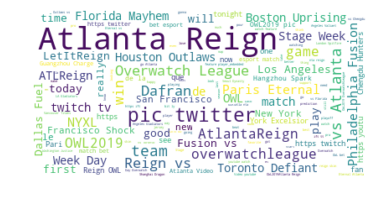

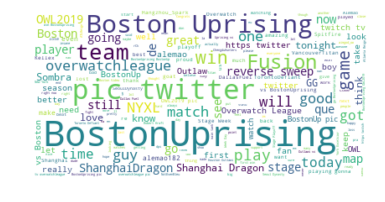

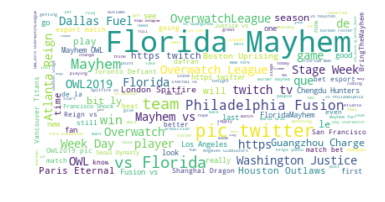

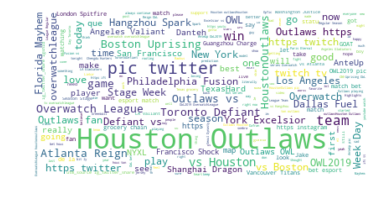

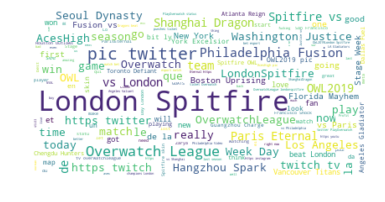

...

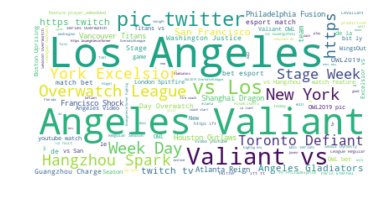

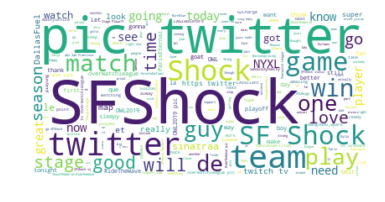

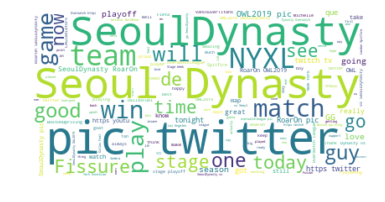

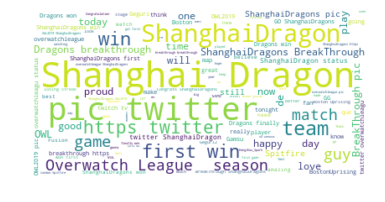

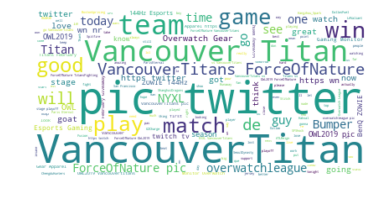

In [40]:
for t_name in env.team_list:
    generate_word_cloud_by_team(
        team_name=t_name, team_file_paths=env.team_file_paths)

### Generate wordcloud with mask

In [45]:
import numpy as np
from PIL import Image
from wordcloud import WordCloud, ImageColorGenerator,STOPWORDS


def wordcloud_image(team_name='Shanghai Dragons',
                    team_file_paths='',
                    show_img=True):
    mask = np.array(Image.open(os.path.join(env.logo_dir, team_name + '.png')))
    t_list = get_data_by_team_name(
        team_name=team_name, team_file_paths=team_file_paths)
    text = extract_text_from_list(t_list)
    image_colors = ImageColorGenerator(mask)
    wordcloud = WordCloud(stopwords=list(STOPWORDS)+env.stopwords+team_name.split(),
        background_color="white", mode="RGBA", max_words=1000,
        mask=mask).generate(text).recolor(color_func=image_colors)
    f, ax = plt.subplots(1, 2, figsize=[50, 50])
    ax[0].imshow(mask)
    ax[1].imshow(wordcloud, interpolation="bilinear")
    ax[0].axis("off")
    ax[1].axis("off")
    if show_img:
        plt.show()
    else:
        return wordcloud

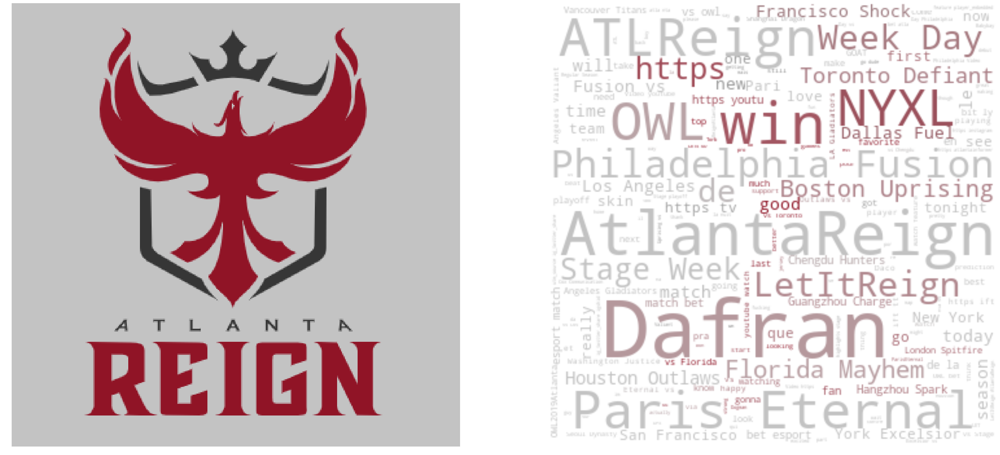

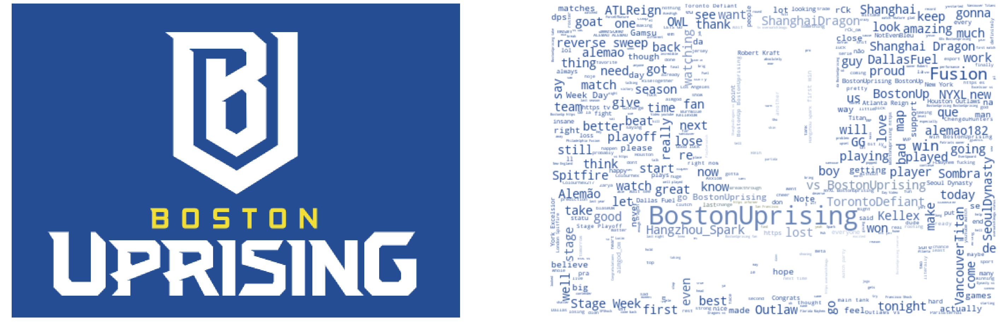

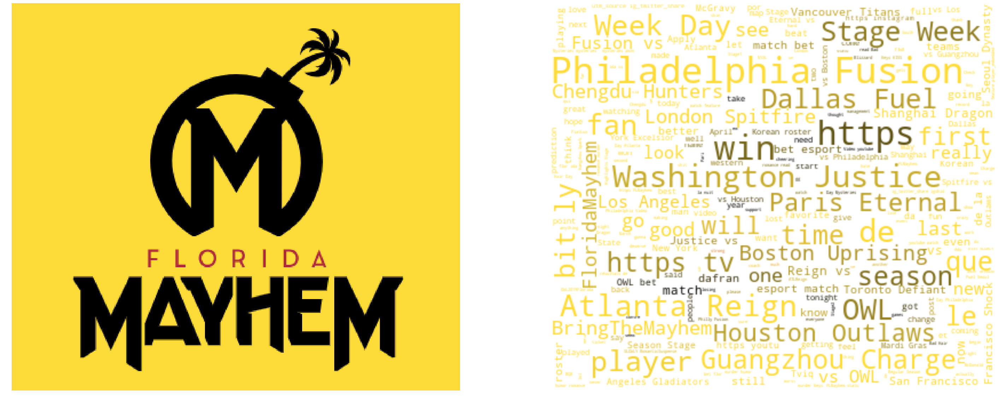

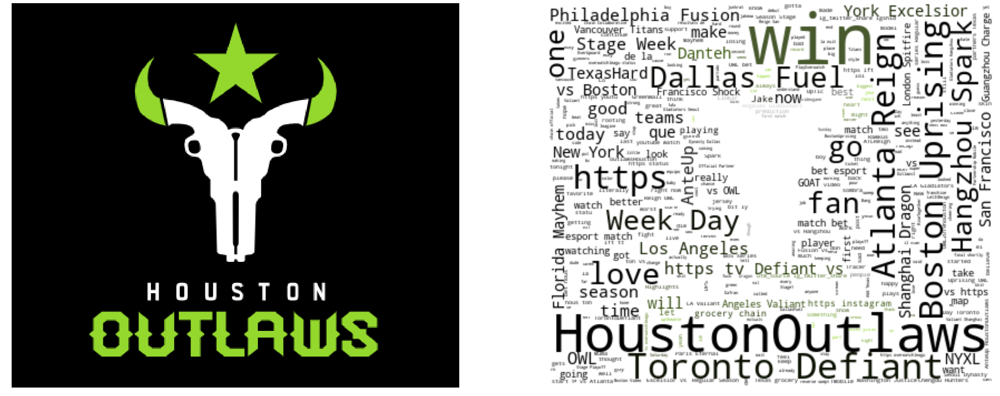

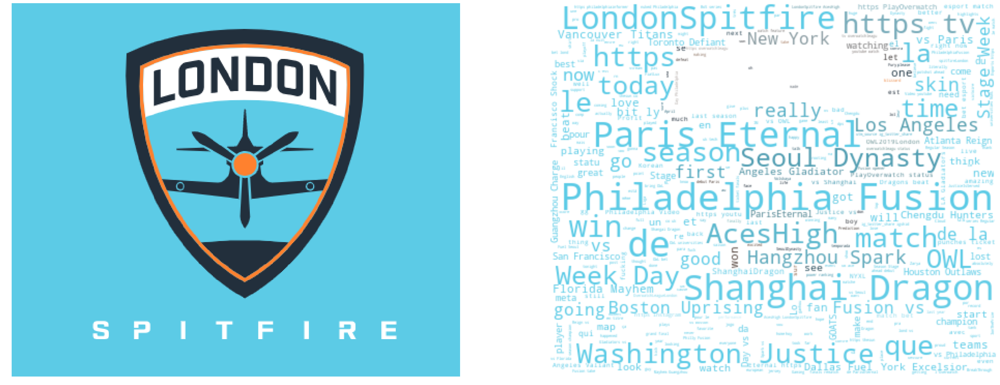

...

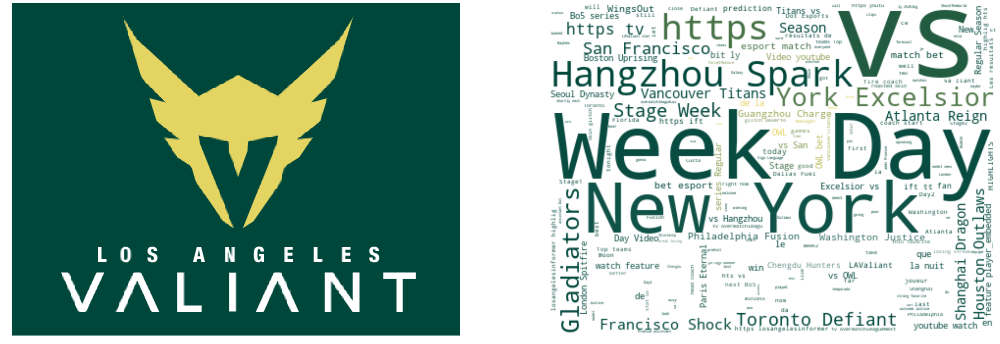

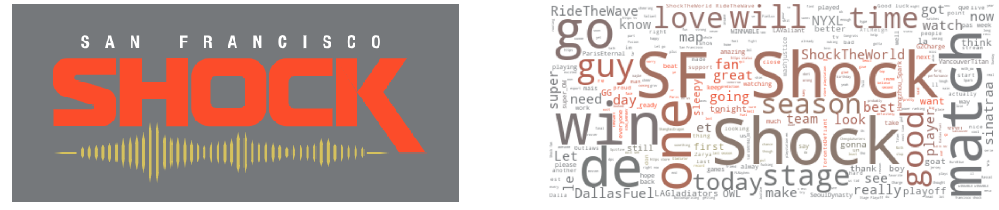

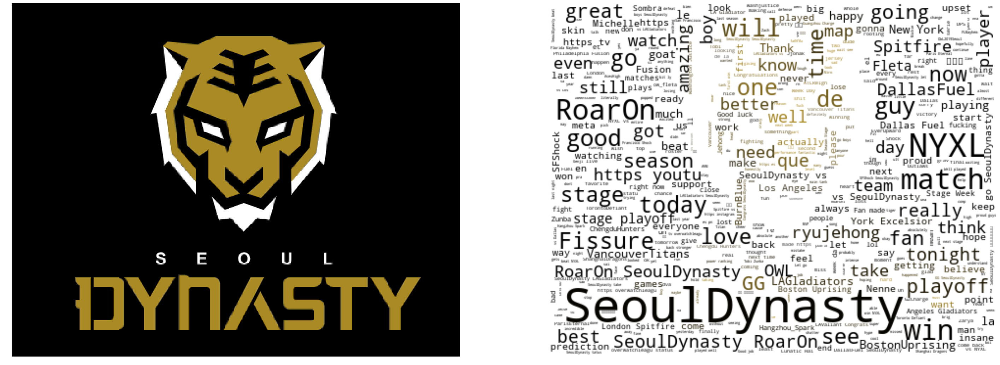

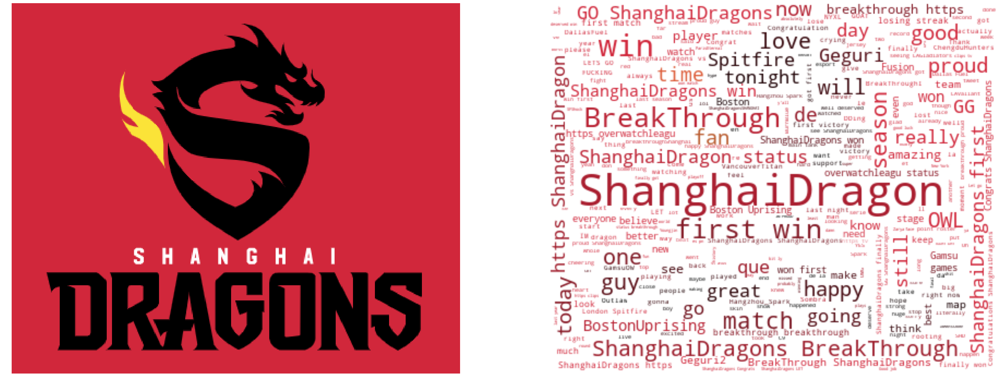

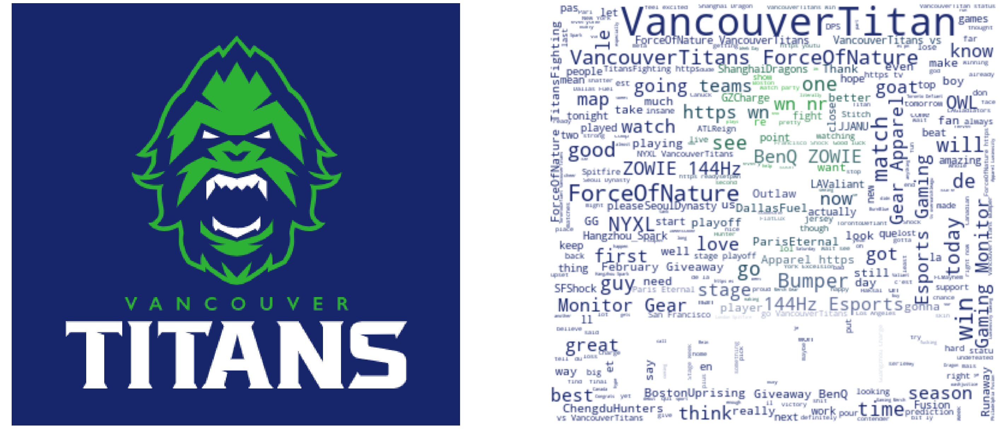

In [46]:
for t_name in env.team_list:
    wordcloud_image(
        team_name=t_name, team_file_paths=env.team_file_paths)